In [1]:
import os, json, cv2, numpy as np, torch, rasterio
from rasterio.windows import Window
from ultralytics import YOLO
from tqdm import tqdm
from pathlib import Path
from rasterio.enums import Resampling

In [2]:
def iou(boxA, boxB):
    x1 = max(boxA[0], boxB[0]); y1 = max(boxA[1], boxB[1])
    x2 = min(boxA[2], boxB[2]); y2 = min(boxA[3], boxB[3])
    inter = max(0, x2 - x1) * max(0, y2 - y1)
    areaA = (boxA[2]-boxA[0]) * (boxA[3]-boxA[1])
    areaB = (boxB[2]-boxB[0]) * (boxB[3]-boxB[1])
    return inter / (areaA + areaB - inter + 1e-6)

# Condensed the global NMS code into function
def global_nms(boxes, thresh=0.4):
    if not boxes:
        return []
    arr = np.array(boxes)         # [N, 6]
    order = arr[:,4].argsort()[::-1]
    keep = []
    while order.size:
        i = order[0]
        keep.append(i)
        if order.size == 1:
            break
        rest = order[1:]
        ious = [iou(arr[i], arr[j]) for j in rest]
        order = rest[np.array(ious) < thresh]
    return arr[keep].tolist()


In [3]:
# Running the windowed inferencing via function

def run_detector(
        tif_path,
        model_path,
        tile_wh=200,
        stride=100,
        conf_th=0.3,
        nms_th=0.5,
        preview_scale=0.2,
        save_image = False,
        save_path = "detector_output.png"
    ):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model  = YOLO(model_path).to(device)
    
    detections_px = []   # [x1,y1,x2,y2,conf,cls]

    with rasterio.open(tif_path) as src:
        H, W = src.height, src.width
        transform = src.transform
        for top in tqdm(range(0, H, stride), desc="rows"):
            if top + tile_wh > H:
                top = H - tile_wh
            for left in range(0, W, stride):
                if left + tile_wh > W:
                    left = W - tile_wh
                win = Window(left, top, tile_wh, tile_wh)
                tile = src.read(1, window=win)        # (H,W) grayscale
                tile = np.stack([tile]*3, axis=-1)     # (H,W,3) for YOLO
                results = model.predict(tile, conf=conf_th, verbose=False, device=device)
                if results and len(results[0].boxes):
                    for b in results[0].boxes:
                        x1,y1,x2,y2 = b.xyxy[0].tolist()
                        conf = b.conf[0].item()
                        cls  = int(b.cls[0].item())
                        detections_px.append([
                            left + x1, top + y1,
                            left + x2, top + y2,
                            conf, cls
                        ])
                if left + tile_wh >= W:
                    break
            if top + tile_wh >= H:
                break

    final_px = global_nms(detections_px, nms_th)

    # Setup display with bounding boxes and confidences
    if preview_scale:
        with rasterio.open(tif_path) as src:
            full = src.read(1)
        preview = np.stack([full]*3, -1)
        if preview_scale < 1.0:
            preview = cv2.resize(
                preview,
                (int(W*preview_scale), int(H*preview_scale)),
                interpolation=cv2.INTER_AREA
            )
        for x1,y1,x2,y2,conf,cls in final_px:
            x1,y1,x2,y2 = [int(v*preview_scale) for v in (x1,y1,x2,y2)]
            cv2.rectangle(preview,(x1,y1),(x2,y2),(0,0,255),2)
            cv2.putText(preview,
                        f"{model.names[int(cls)]}:{conf:.2f}",
                        (x1,max(y1-4,0)),
                        cv2.FONT_HERSHEY_SIMPLEX,0.4,(0,0,255),1)
        from IPython.display import display, Image as IPyImage
        _, buf = cv2.imencode(".png", preview)
        display(IPyImage(data=buf.tobytes()))

        # Save?
        if save_image:
            cv2.imwrite(save_path, preview)

    return final_px, model.names


In [4]:
# Wanted a way to compile a list of all the full directories for every image downloaded, when given the top common
# directory for all of the images

top_path = Path("/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata")

tif_paths = []
for uuid_dir in top_path.iterdir():
    if not uuid_dir.is_dir():
        continue
    # inside each photo ID directory there should be exactly one timestamp folder, which then has the image
    for ts_dir in uuid_dir.iterdir():
        if not ts_dir.is_dir():
            continue
        # grab the single .tif file in that timestamp folder
        tif_paths.extend([str(p) for p in ts_dir.glob("*.tif")])

print(f"Found {len(tif_paths)} GeoTIFFs")

tif_paths[:5]

Found 200 GeoTIFFs


['/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata/18af9cab-1369-4761-8e64-4fe4d33e6d77/2023-11-29-02-44-02_UMBRA-04/2023-11-29-02-44-02_UMBRA-04_GEC.tif',
 '/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata/10b2b59b-3652-44bb-8d6e-33c180b416d7/2023-07-02-14-04-48_UMBRA-04/2023-07-02-14-04-48_UMBRA-04_GEC.tif',
 '/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata/2a50e27d-b75e-4ce9-8da3-039ed943623b/2023-01-23-02-43-34_UMBRA-04/2023-01-23-02-43-34_UMBRA-04_GEC.tif',
 '/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata/2ce85c4f-1184-4d93-95d9-c7609b2ff310/2024-02-13-01-46-04_UMBRA-06/2024-02-13-01-46-04_UMBRA-06_GEC.tif',
 '/home/tjriz/Documents/Senior-Design/datasets/tif-images/sar-data/tasks/ship_detection_testdata/29043e9b-45be-4539-8575-fe5a796aa517/2023-11-09-15-07-14_UMBRA-04/2023-11-09-15-07-14_UMBRA-04_

rows:  98%|█████████▊| 130/132 [01:22<00:01,  1.57it/s]


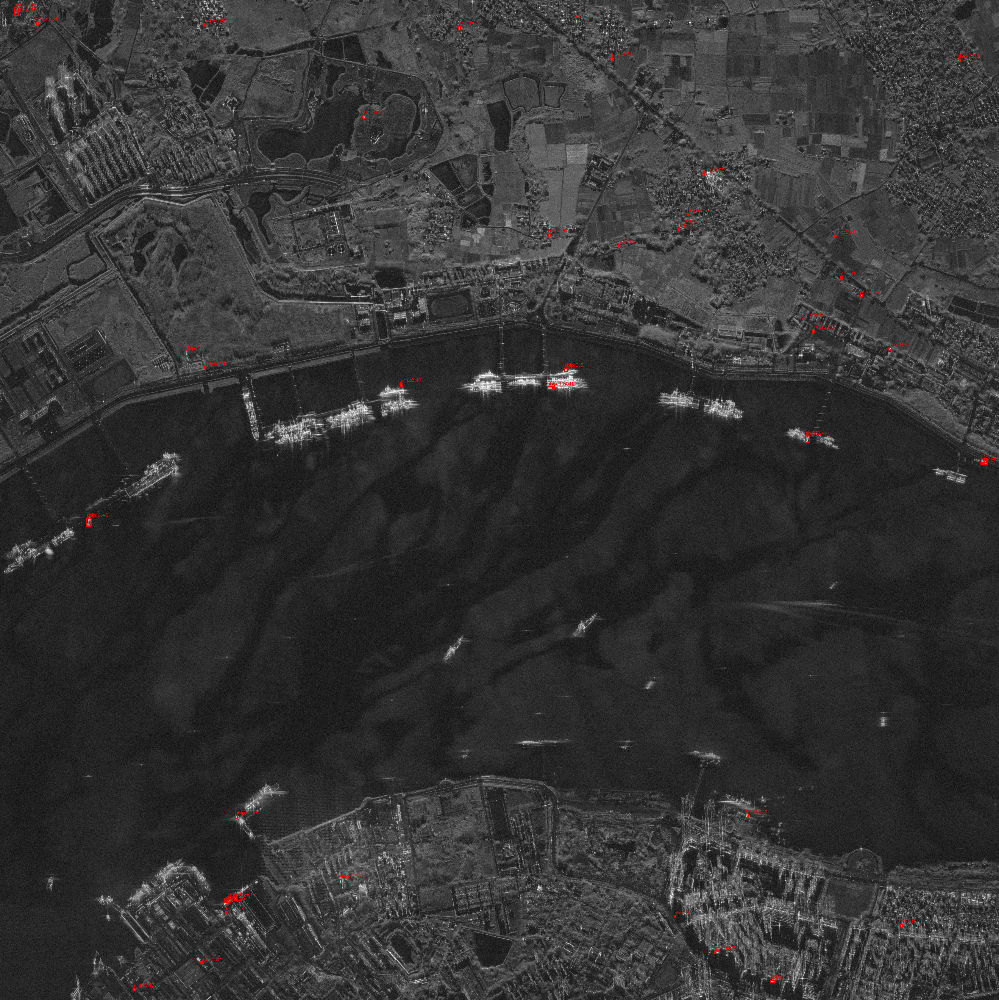

45 final detections


In [13]:
# Just for the interest of seeing what the results would be, ran the sliding window technique on the full resolution
# image with no downsampling whatsoever. Obviously, this takes quite a while to run and also the results were not good.

tif_path = tif_paths[17]

weights_pt = "/home/tjriz/Documents/Senior-Design/YOLOv11_training_HRSID/runs/detect/HRSID_update-tj/weights/best.pt"

boxes, class_names = run_detector(
    tif_path=tif_path,
    model_path=weights_pt,
    tile_wh=200,       # patch size
    stride=100,        # overlap stride
    conf_th=0.3,
    # nms_th=0.4,
    nms_th=0.5,
    preview_scale=0.2,  # set to 0 to skip preview
    save_image = True,
    save_path = "UMBRA-detections_report-noscaling.png"
)

print(f"{len(boxes)} final detections")

# boxes format: [x1, y1, x2, y2, conf, class_id]

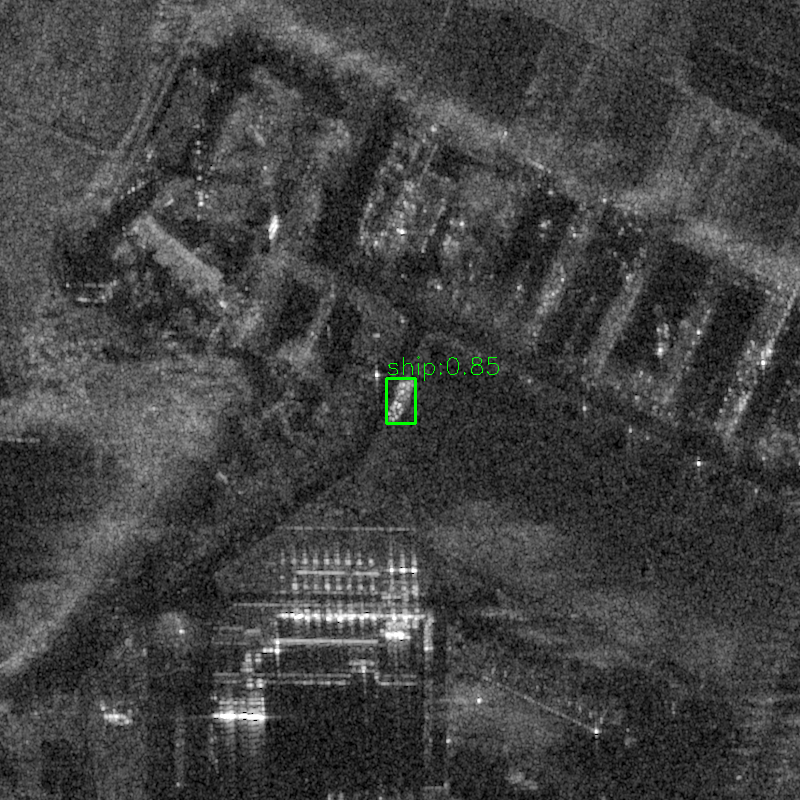

Detection 0: class=ship, conf=0.85


True

In [38]:
# Code for inspecting individual detections by zooming in

with rasterio.open(tif_path) as src:
    read_image = src.read(1)            # (H, W) grayscale
large_image = np.stack([read_image]*3, -1)   # make it RGB‑shaped for display

# Choose which detection to inspect
det_id   = 0
# half‑width / half‑height of the zoom window in pixels
half_win = 400        

# Pull the selected box
x1, y1, x2, y2, conf, cls_id = boxes[det_id]
x1 = int(round(x1)); y1 = int(round(y1))
x2 = int(round(x2)); y2 = int(round(y2))

# Box center
cx = (x1 + x2) // 2
cy = (y1 + y2) // 2

# Crop coordinates (clamped to image bounds)
left   = max(cx - half_win, 0)
right  = min(cx + half_win, large_image.shape[1])
top    = max(cy - half_win, 0)
bottom = min(cy + half_win, large_image.shape[0])

# Extract the crop and draw the box on it for context
crop = large_image[top:bottom, left:right].copy()
cv2.rectangle(
    crop,
    (x1 - left, y1 - top),
    (x2 - left, y2 - top),
    (0, 255, 0),
    2,
)
# Overlaying class and confidence as text
cv2.putText(
    crop, 
    f"{model.names[int(cls)]}:{conf:.2f}",
    (x1 - left,max(y1 - top - 4,0)), 
    cv2.FONT_HERSHEY_SIMPLEX,0.8,(0,255,0),1)

# Display
from IPython.display import display, Image as IPyImage
_, buf = cv2.imencode(".png", cv2.cvtColor(crop, cv2.COLOR_RGB2BGR))
display(IPyImage(data=buf.tobytes()))
print(f"Detection {det_id}: class={class_names[cls_id]}, conf={conf:.2f}")

# to save
# out_path = "UMBRA_incorrect_detection.png"
# cv2.imwrite(out_path, crop)

In [20]:
# Downsampling entire image and then doing same window/kernel method

# As the way of doing things in the following cell, by downsampling per (larger) window instance and then upconverting, seemed
# to be a bit more optimal, and because they essentially are working towards achieving the same thing, I commented this out simply
# to suppress the output for the purposes of pushing to GitHub repo without issue

# # configurable parameters
# down_factor = 0.1
# tile_wh = 200  
# stride = 100     
# conf_th = 0.2
# nms_th = 0.4
# device = "cuda" if torch.cuda.is_available() else "cpu"

# # Load and downsample 
# with rasterio.open(tif_path) as src:
#     h_ds = int(src.height * down_factor)
#     w_ds = int(src.width  * down_factor)
#     # (h_ds, w_ds) needed later
#     band = src.read(1, out_shape=(h_ds, w_ds), resampling=Resampling.average)
# full_transform = src.transform

# # RGB‑shaped for YOLO
# img_ds = np.stack([band]*3, axis=-1)

# # sliding window detection on the downsampled image
# model = YOLO(weights_pt).to(device)

# # boxes in down‑sampled pixels
# all_boxes = []

# for top in tqdm(range(0, h_ds, stride), desc="rows"):
#     if top + tile_wh > h_ds: top = h_ds - tile_wh
#     for left in range(0, w_ds, stride):
#         if left + tile_wh > w_ds: left = w_ds - tile_wh
#         tile = img_ds[top:top+tile_wh, left:left+tile_wh]

#         res = model.predict(tile, conf=conf_th, verbose=False, device=device)
#         if res and len(res[0].boxes):
#             for b in res[0].boxes:
#                 x1,y1,x2,y2 = b.xyxy[0].tolist()
#                 conf = b.conf[0].item()
#                 cls  = int(b.cls[0].item())
#                 all_boxes.append([left+x1, top+y1, left+x2, top+y2, conf, cls])

#         if left + tile_wh >= w_ds: break
#     if top + tile_wh >= h_ds: break

# # global NMS on downsampled coordinates
# final_ds = global_nms(all_boxes, nms_th)

# # scaling boxes back for displaying on original image
# scale = 1.0 / down_factor
# final_full = [[
#     x1*scale, y1*scale, x2*scale, y2*scale, conf, cls
# ] for x1,y1,x2,y2,conf,cls in final_ds]

# print(f"{len(final_full)} detections mapped to original resolution")

# preview_scale = 0.1
# with rasterio.open(tif_path) as src:
#     full_band = src.read(1)
# full_rgb = np.stack([full_band]*3, -1)
# preview = cv2.resize(full_rgb,
#                      (int(full_rgb.shape[1]*preview_scale),
#                       int(full_rgb.shape[0]*preview_scale)),
#                      interpolation=cv2.INTER_AREA)

# for x1,y1,x2,y2,conf,cls in final_full:
#     x1,y1,x2,y2 = [int(v*preview_scale) for v in (x1,y1,x2,y2)]
#     cv2.rectangle(preview,(x1,y1),(x2,y2),(0,0,255),2)
#     cv2.putText(preview,
#                 f"{model.names[int(cls)]}:{conf:.2f}",
#                 (x1,max(y1-4,0)),
#                 cv2.FONT_HERSHEY_SIMPLEX,0.4,(0,0,255),1)

# from IPython.display import display, Image as IPyImage
# _, buf = cv2.imencode(".png", preview)
# display(IPyImage(data=buf.tobytes()))


rows:  82%|████████▏ | 9/11 [00:02<00:00,  3.27it/s]


Detections after NMS: 15


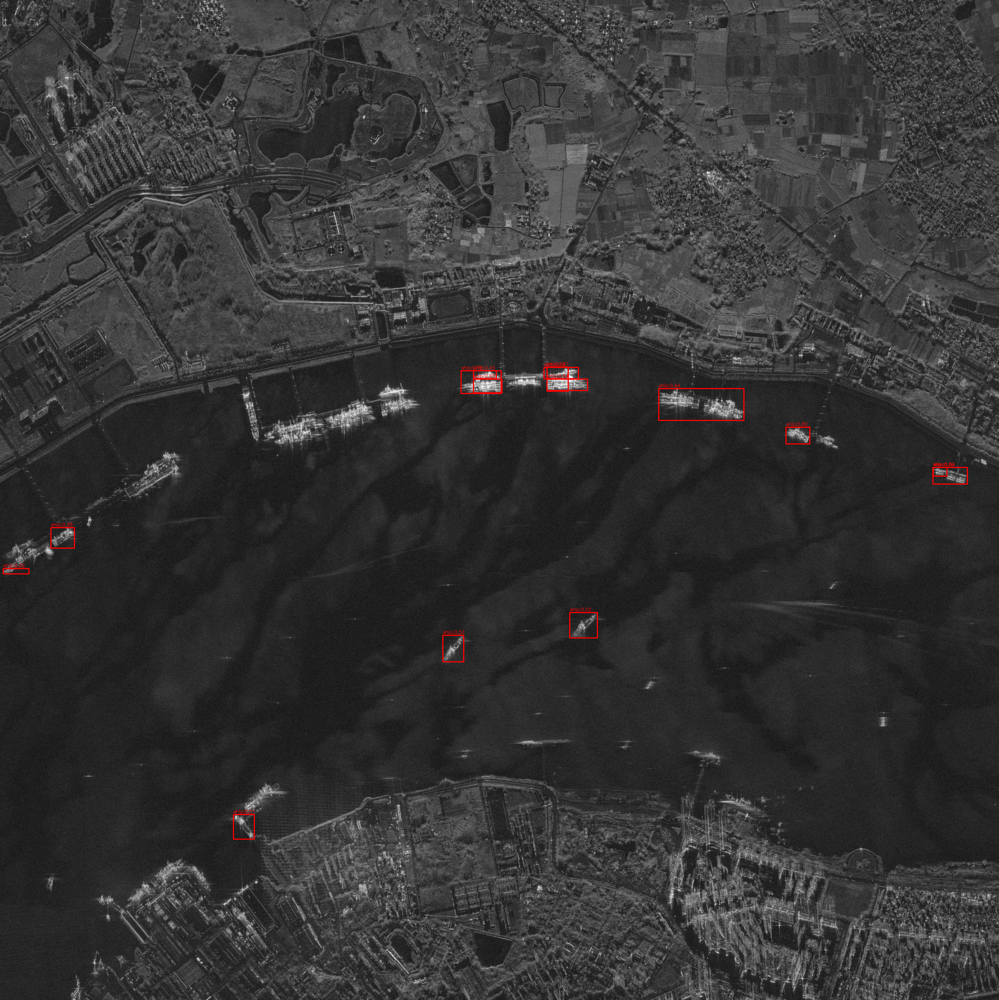

True

In [39]:
# Trying some larger window sizes and stride values, and downsampling per window instance

win_full   = 2500     # window size on full‑res raster
resize_to  = 224      # network input size
stride     = 1250      # overlap stride on full‑res raster
# conf_th    = 0.1
conf_th    = 0.3
# nms_th     = 0.4
nms_th     = 0.5

device = "cuda" if torch.cuda.is_available() else "cpu"
model  = YOLO(weights_pt).to(device)

scale_down = resize_to / win_full
scale_up   = 1.0 / scale_down

# sliding window inference
all_boxes=[]
with rasterio.open(tif_path) as src:
    H, W = src.height, src.width
    for top in tqdm(range(0, H, stride), desc="rows"):
        if top + win_full > H: top = H - win_full
        for left in range(0, W, stride):
            if left + win_full > W: left = W - win_full

            win  = Window(left, top, win_full, win_full)
            # grayscale (win_full,win_full)
            tile = src.read(1, window=win)
            tile_rgb = np.stack([tile]*3, -1)
            tile_rs  = cv2.resize(tile_rgb, (resize_to,resize_to),
                                  interpolation=cv2.INTER_AREA)

            res = model.predict(tile_rs, conf=conf_th, verbose=False, device=device)
            if res and len(res[0].boxes):
                for b in res[0].boxes:
                    x1,y1,x2,y2 = b.xyxy[0].tolist()
                    conf = b.conf[0].item()
                    cls  = int(b.cls[0].item())
                    all_boxes.append([
                        left + x1*scale_up,
                        top  + y1*scale_up,
                        left + x2*scale_up,
                        top  + y2*scale_up,
                        conf,
                        cls
                    ])
            if left + win_full >= W: break
        if top + win_full >= H: break

final_boxes = global_nms(all_boxes, nms_th)
print(f"Detections after NMS: {len(final_boxes)}")

max_dim = 2000
# preview_scale = min(max_dim/max(H,W), 1.0)
preview_scale = 0.2
with rasterio.open(tif_path) as src:
    preview_band = src.read(
        1,
        out_shape=(int(H*preview_scale), int(W*preview_scale)),
        resampling=Resampling.average
    )
preview = np.stack([preview_band]*3, -1)

for x1,y1,x2,y2,conf,cls in final_boxes:
    x1,y1,x2,y2 = [int(v*preview_scale) for v in (x1,y1,x2,y2)]
    cv2.rectangle(preview,(x1,y1),(x2,y2),(0,0,255),2)
    cv2.putText(preview,
                f"{model.names[int(cls)]}:{conf:.2f}",
                (x1,max(y1-4,0)),
                cv2.FONT_HERSHEY_SIMPLEX,0.4,(0,0,255),1)

# Makeshift for loop for displaying only a single detection for the purposes of generating a figure for presentation poster
# box_count = 1
# for x1,y1,x2,y2,conf,cls in final_boxes:
#     if box_count == 7:
#         x1,y1,x2,y2 = [int(v*preview_scale) for v in (x1,y1,x2,y2)]
#         cv2.rectangle(preview,(x1,y1),(x2,y2),(0,0,255),2)
#         cv2.putText(preview,
#                     f"{model.names[int(cls)]}:{conf:.2f}",
#                     (x1,max(y1-4,0)),
#                     cv2.FONT_HERSHEY_SIMPLEX,0.4,(0,0,255),1)
#     box_count+=1
    
_, buf = cv2.imencode(".png", preview)
display(IPyImage(data=buf.tobytes()))

# to save
# out_path = "UMBRA_report_windowed.png"
# cv2.imwrite(out_path, preview)

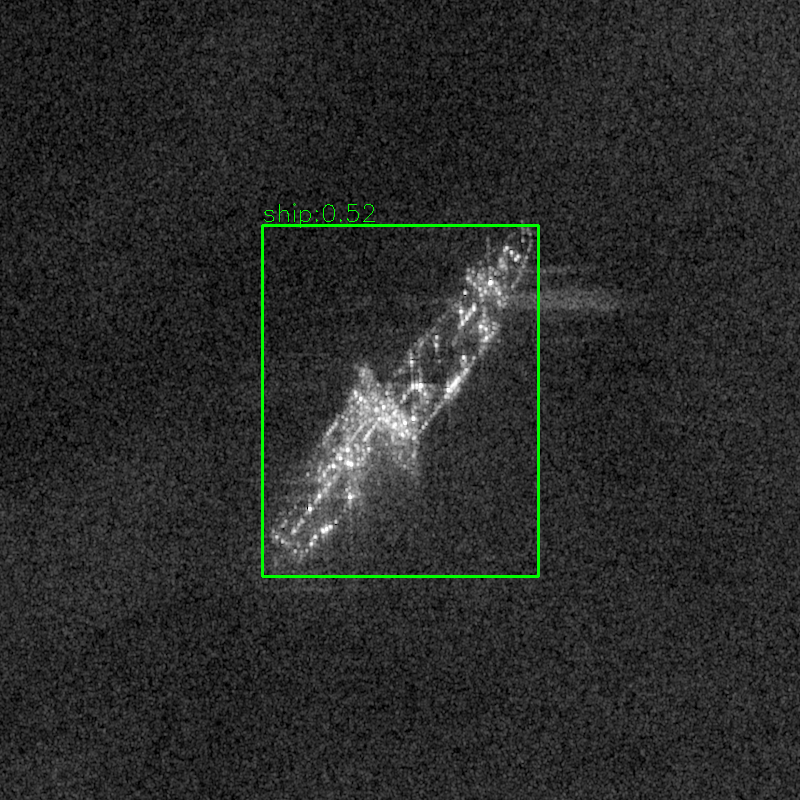

Detection 0: class=ship, conf=0.52


True

In [40]:
# Code for inspecting individual detections by zooming in, now after appropriate window size with downsampling

with rasterio.open(tif_path) as src:
    read_image = src.read(1)            # (H, W) grayscale
large_image = np.stack([read_image]*3, -1)   # make it RGB‑shaped for display

# Choose which detection to inspect
box_id   = 8
# half‑width / half‑height of the zoom window in pixels
half_win = 400        

# Pull the selected box
x1, y1, x2, y2, conf, cls_id = final_boxes[box_id]
x1 = int(round(x1)); y1 = int(round(y1))
x2 = int(round(x2)); y2 = int(round(y2))

# Box center
cx = (x1 + x2) // 2
cy = (y1 + y2) // 2

# Crop coordinates (clamped to image bounds)
left   = max(cx - half_win, 0)
right  = min(cx + half_win, large_image.shape[1])
top    = max(cy - half_win, 0)
bottom = min(cy + half_win, large_image.shape[0])

# Extract the crop and draw the box on it for context
crop = large_image[top:bottom, left:right].copy()
cv2.rectangle(
    crop,
    (x1 - left, y1 - top),
    (x2 - left, y2 - top),
    (0, 255, 0),
    2,
)
# Overlaying class and confidence as text
cv2.putText(
    crop, 
    f"{model.names[int(cls)]}:{conf:.2f}",
    (x1 - left,max(y1 - top - 4,0)), 
    cv2.FONT_HERSHEY_SIMPLEX,0.8,(0,255,0),1)

# Display
from IPython.display import display, Image as IPyImage
_, buf = cv2.imencode(".png", cv2.cvtColor(crop, cv2.COLOR_RGB2BGR))
display(IPyImage(data=buf.tobytes()))
print(f"Detection {det_id}: class={class_names[cls_id]}, conf={conf:.2f}")

# to save
# out_path = "UMBRA_correct_detection.png"
# cv2.imwrite(out_path, crop)